In [1]:
from pathlib import Path
import vaex
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

from matplotlib import animation

from scipy.optimize import minimize, curve_fit

from scipy import interpolate

import illustris_python as il

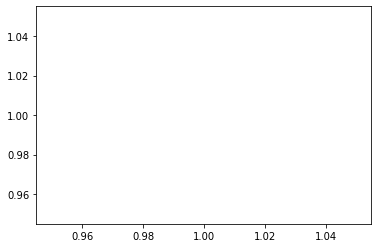

In [2]:
%matplotlib inline


plt.plot([1],[1])

font = {"weight": "normal", "size": 14}
plt.rcParams["axes.linewidth"] = 1.5  # set the value globally
plt.rc("font", **font)
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["figure.facecolor"] = "white"
_legend = {"frameon": True, "framealpha":0.7}
plt.rc("legend", **_legend)
plt.show()

In [3]:
path = "/net/virgo01/data/users/spirov/Nexus Project/"

fields = ['SubhaloMass',] 
dm = il.snapshot.loadSubset(path,135,"dm")

In [4]:
ids = dm["ParticleIDs"]

In [5]:
dm_pos = dm["Coordinates"]
Xs = dm_pos[:,0]
Ys = dm_pos[:,1]
Zs = dm_pos[:,2]
Vx = dm["Velocities"][:,0]
Vy = dm["Velocities"][:,1]
Vz = dm["Velocities"][:,2]


df = vaex.from_arrays(ID = ids, X=Xs,Y=Ys,Z=Zs,Vx=Vx,Vy=Vy,Vz=Vz)

In [6]:
df.export_hdf5(path+"135.hdf5")

In [7]:
@vaex.register_function()
def correct(x):
    L = 75000
    return np.where(np.abs(x)>L/2, x-np.sign(x)*L,x)

def localizeDataFrame(absDf, x,y,z):
    rx = absDf.X - x
    ry = absDf.Y - y
    rz = absDf.Z - z
    
    L = 75000
    
    relx = rx.correct()
    rely = ry.correct()
    relz = rz.correct()
    
    
    relR = np.sqrt(relx**2 + rely**2+relz**2)
    
    theta = np.arccos(-relz/relR)
    fi = np.arctan2(relx,rely)
    
    relDf = absDf.copy()
    
    Vaway = (relx*absDf.Vx+rely*absDf.Vy+relz*absDf.Vz)/relR
    
    
    relDf["relX"] = relx
    relDf["relY"] = rely
    relDf["relZ"] = relz
    
    
    
    relDf["R"] = relR
    relDf["Th"] = theta
    relDf["Fi"] = fi
    relDf["Vr"] = Vaway
    
#    cz = Vaway * relR/10
    
    
 #   relDf["CZ"] = cz
    
    
    return relDf
    
    

def czPlot(df,tolAng = np.pi*0.3, rad = 3.75e3,name="Relative Plot",GodMode = True,subPlot = None):
    
    tolAng = (np.pi/2)-tolAng
    
    filt = (df.Th>tolAng)*(df.Th<(np.pi-tolAng))
    
    df = df[filt]
    
    if not subPlot:
        plt.figure(figsize=(24,16))
        subPlot = plt.subplot(projection='polar')
        plt.title(f"cz Plot from {name}")
    else:
        if GodMode:
            t = "Real Distribution"
        else:
            t = "Observed Distribution"
        subPlot.set_title(t)
   
    
    r = df.R.values/1e3
    phi = df.Fi.values
    vr = df.Vr.values
    
    
    
    rh= r
    
    cz = rh*100
    
    if not GodMode:
         cz+= vr
            
#    rad *=1e3
   
    filt = cz<rad
    
    cz = cz[filt]
    phi = phi[filt]
    
    subPlot.scatter(phi, cz,alpha=0.01,s=0.01,color='indigo')
    thits = np.linspace(0,2*np.pi,100)
    subPlot.plot(thits,np.full(100,rad),c='black')
    subPlot.set_ylim(0,rad)
    
    # plt.show()
    
cent = 37500

cdf = localizeDataFrame(df, cent,cent,cent)

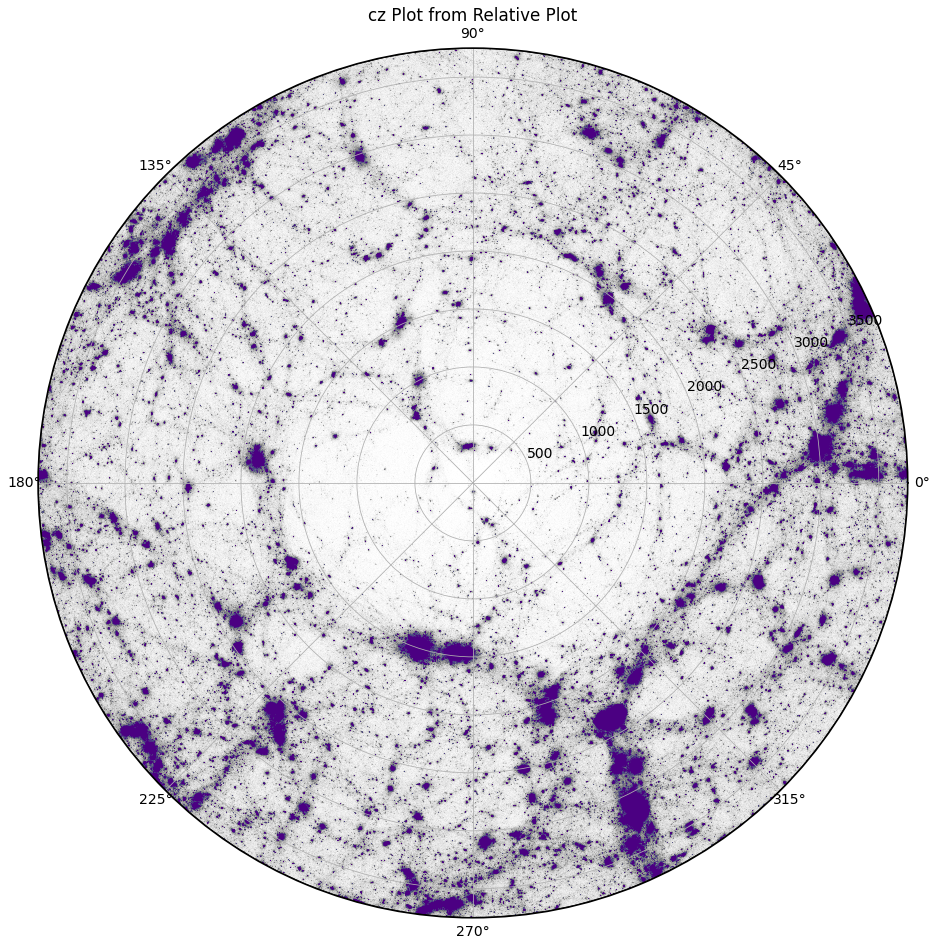

In [8]:
czPlot(cdf)

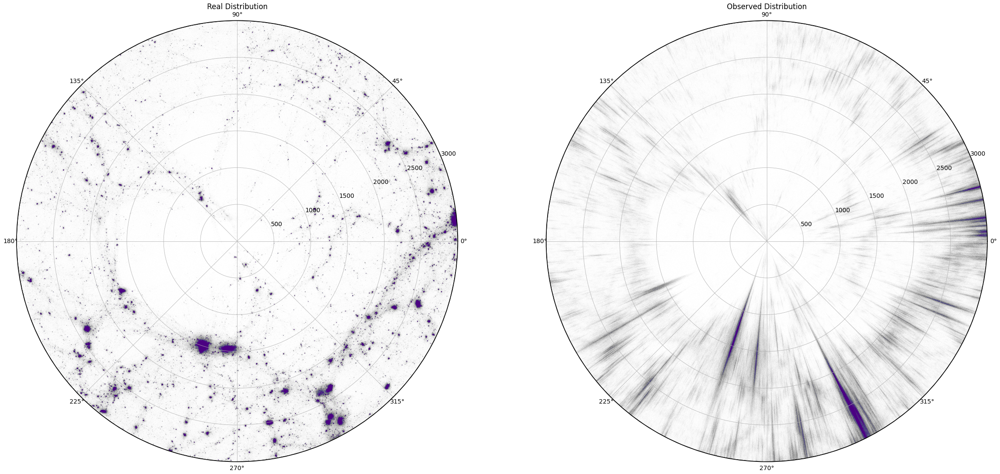

In [9]:
def dualPlot(cdf,ang,rad=3e3,name = None):
    fig = plt.figure(figsize=(40,22))
    ax1 = plt.subplot(121,projection="polar")
    ax2 = plt.subplot(122,projection="polar")

    czPlot(cdf,ang,subPlot = ax1,rad = rad)
    czPlot(cdf,ang,GodMode=False,subPlot = ax2,rad=rad)
    if name:
        plt.suptitle(name)
    plt.show()
    
dualPlot(cdf,0.5)

# Going Places

> Fat

In [10]:
rdf = localizeDataFrame(df,17026.872969109718,45608.2650390964,48593.901957099086)

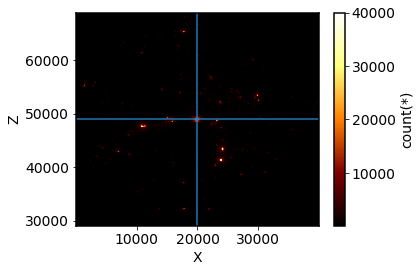

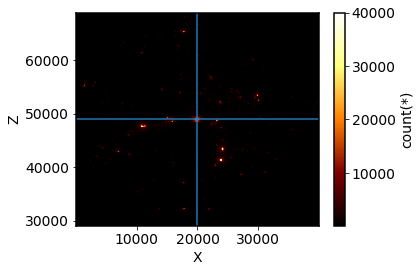

In [11]:
localFrame =rdf[rdf.R<2e4]

localFrame.viz.heatmap("X","Z",vmin=1e2,vmax=4e4)
plt.axvline(2e4)
plt.axhline(4.9e4)
plt.show()

localFrame.viz.heatmap("X","Z",vmin=1e2,vmax=4e4)
plt.axvline(2e4)
plt.axhline(4.9e4)

plt.show()

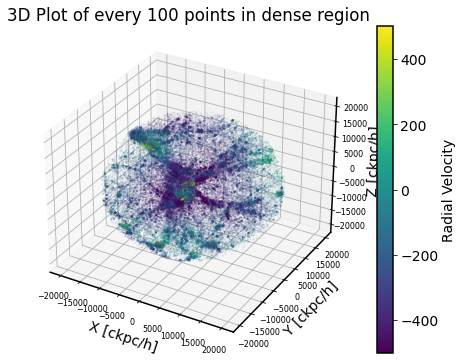

In [12]:
#%matplotlib notebook
n = 100

fig = plt.figure(figsize=(9,6))
ax = fig.add_subplot(projection='3d')


Xs = (localFrame.R*np.sin(localFrame.Th)*np.cos(localFrame.Fi)).values
Ys = (localFrame.R*np.sin(localFrame.Th)*np.sin(localFrame.Fi)).values
Zs = (localFrame.R*np.cos(localFrame.Th)).values
vrs = localFrame.Vr.values

#print("doing it boss")


sc = ax.scatter(Xs[::n],Ys[::n],Zs[::n],s=0.5,alpha = .1,c=vrs[::n],vmin = -500,vmax=500)
ax.set_title(f"3D Plot of every {n} points in dense region")
ax.set_xlabel(f"X [ckpc/h]")
ax.set_ylabel(f"Y [ckpc/h]")
ax.set_zlabel(f"Z [ckpc/h]")

ax.tick_params(axis='both', which='major', labelsize=8)

cb= fig.colorbar(sc)
cb.set_label("Radial Velocity")
cb.solids.set(alpha=1)

plt.show()



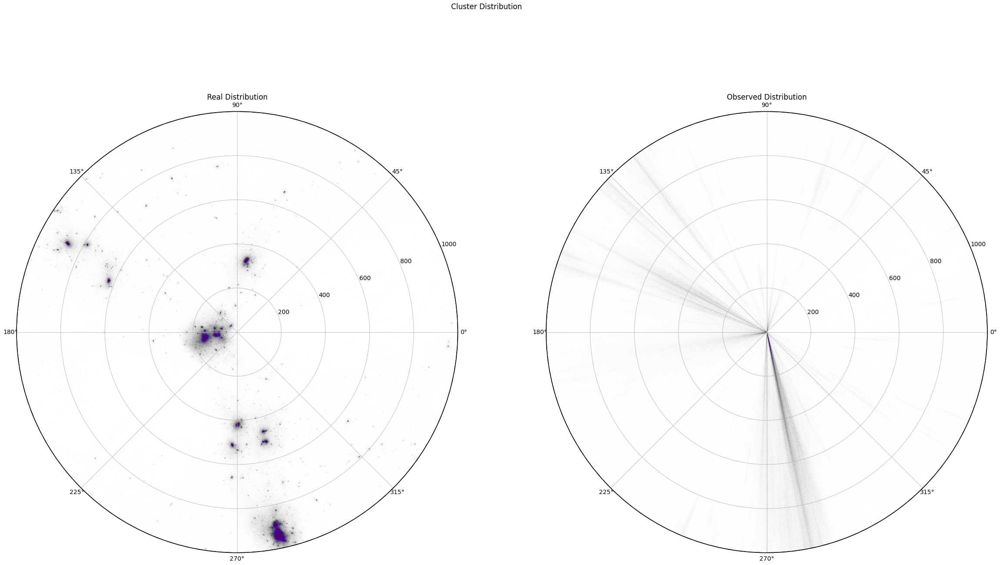

In [13]:
#%matplotlib inline

dualPlot(rdf,np.pi/8,rad=1e3,name="Cluster Distribution")

> Void

In [14]:
vdf = localizeDataFrame(df,1957.97627633503,72164.78076065713,62057.81325270321)

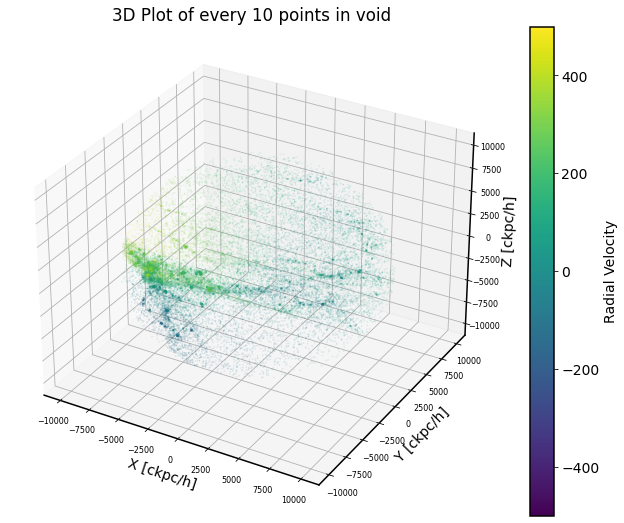

In [15]:
#%matplotlib notebook
n = 10

fig = plt.figure(figsize=(12,9))
ax = fig.add_subplot(projection='3d')

localFrame =vdf[rdf.R<1e4]

Xs = (localFrame.R*np.sin(localFrame.Th)*np.cos(localFrame.Fi)).values
Ys = (localFrame.R*np.sin(localFrame.Th)*np.sin(localFrame.Fi)).values
Zs = (localFrame.R*np.cos(localFrame.Th)).values
vrs = localFrame.Vr.values

#print("doing it boss")


sc = ax.scatter(Xs[::n],Ys[::n],Zs[::n],s=0.5,alpha = .1,c=vrs[::n],vmin = -500,vmax=500)
ax.set_title(f"3D Plot of every {n} points in void")
ax.set_xlabel(f"X [ckpc/h]")
ax.set_ylabel(f"Y [ckpc/h]")
ax.set_zlabel(f"Z [ckpc/h]")

ax.tick_params(axis='both', which='major', labelsize=8)

cb= fig.colorbar(sc)
cb.set_label("Radial Velocity")
cb.solids.set(alpha=1)

plt.show()



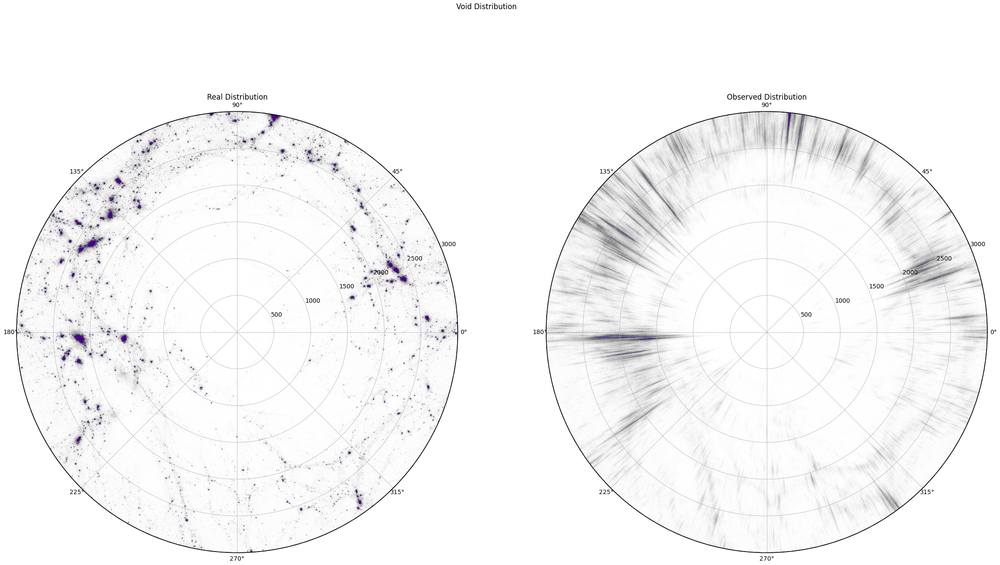

In [16]:
#%matplotlib inline
#plt.suptitle()
dualPlot(vdf,np.pi/8,rad=3e3,name = "Void Distribution")

> thread

In [17]:

tdf = localizeDataFrame(df,57902.70775442519, 49939.84294854744,57851.80161638641)

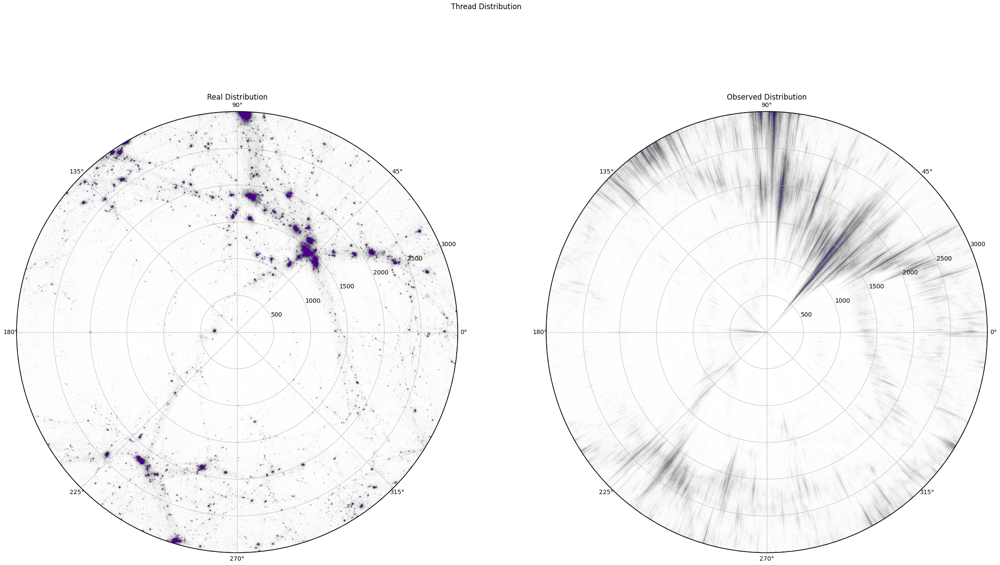

In [18]:
dualPlot(tdf,np.pi/8,rad=3e3,name = "Thread Distribution")

>rand

In [19]:
a = np.random.uniform(0,7.5e4)
b = np.random.uniform(0,7.5e4)
c = np.random.uniform(0,7.5e4)
ndf = localizeDataFrame(df,a,b,c)

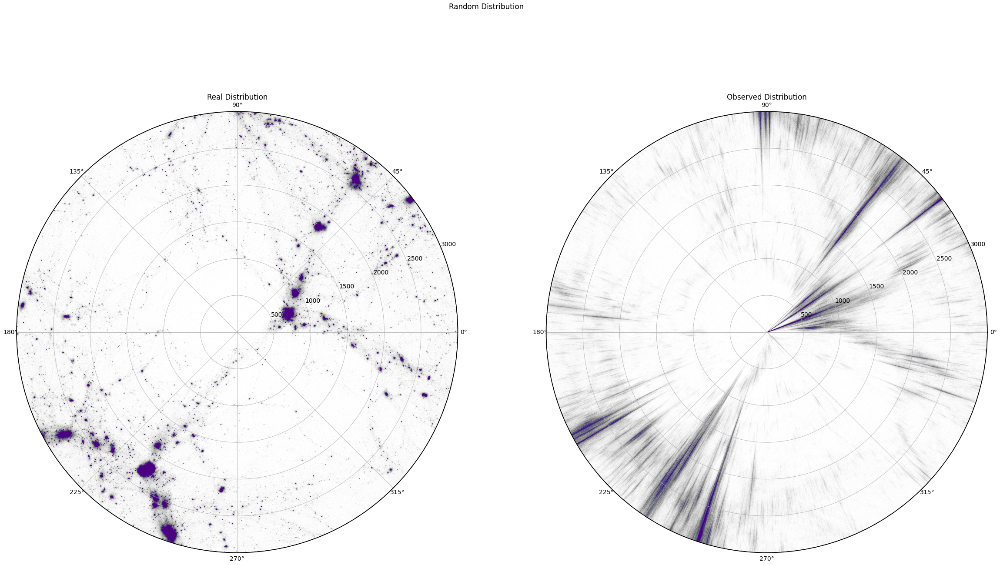

In [20]:
dualPlot(ndf,np.pi/8,rad=3e3,name = "Random Distribution")

In [21]:
a, b ,c


(38058.896473464694, 59897.28585085625, 43894.73849132543)

In [22]:

ndf = localizeDataFrame(df,a,b,c)

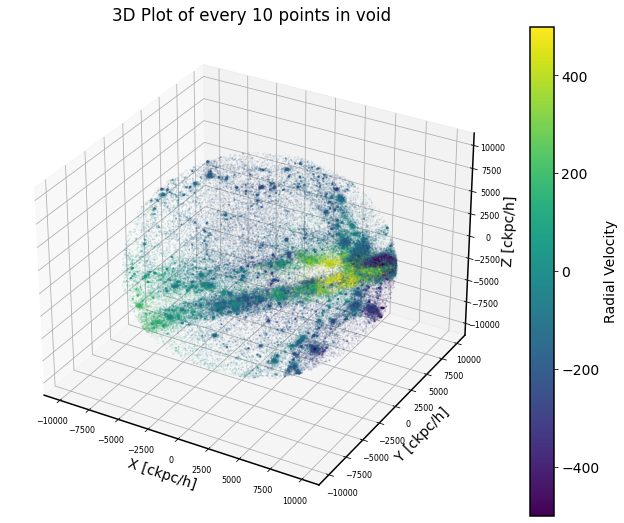

In [23]:
#%matplotlib notebook
n = 10

fig = plt.figure(figsize=(12,9))
ax = fig.add_subplot(projection='3d')

localFrame =ndf[rdf.R<1e4]

Xs = (localFrame.R*np.sin(localFrame.Th)*np.cos(localFrame.Fi)).values
Ys = (localFrame.R*np.sin(localFrame.Th)*np.sin(localFrame.Fi)).values
Zs = (localFrame.R*np.cos(localFrame.Th)).values
vrs = localFrame.Vr.values

#print("doing it boss")


sc = ax.scatter(Xs[::n],Ys[::n],Zs[::n],s=0.5,alpha = .1,c=vrs[::n],vmin = -500,vmax=500)
ax.set_title(f"3D Plot of every {n} points in void")
ax.set_xlabel(f"X [ckpc/h]")
ax.set_ylabel(f"Y [ckpc/h]")
ax.set_zlabel(f"Z [ckpc/h]")

ax.tick_params(axis='both', which='major', labelsize=8)

cb= fig.colorbar(sc)
cb.set_label("Radial Velocity")
cb.solids.set(alpha=1)

plt.show()



In [24]:
rdf

#,ID,X,Y,Z,Vx,Vy,Vz,relX,relY,relZ,R,Th,Fi,Vr
0,88038007,860.2786,26320.94,18281.758,37.119167,-126.95646,-137.56683,-19139.720703125,-22679.060546875,-30718.2421875,42711.58038486001,0.7681436211466302,-2.440628444924103,149.71616542399605
1,88173007,862.8968,26320.16,18283.193,-62.20938,-280.38562,-148.18048,-19137.103515625,-22679.83984375,-30716.806640625,42709.789000923905,0.7681485809103067,-2.440712782669481,283.3364385335515
2,3638407,859.6459,26324.168,18280.25,79.16669,-229.4381,-60.910133,-19140.353515625,-22675.83203125,-30719.75,42711.23424902472,0.7680844211754512,-2.4405419768068675,130.14293538700878
3,3439732,861.843,26322.36,18286.85,-63.35342,-266.66763,-153.27612,-19138.15625,-22677.640625,-30713.150390625,42706.4633970458,0.7681911943311281,-2.4406378741283654,280.22580356999504
4,81301332,860.39545,26319.984,18284.232,187.94035,-223.2462,-114.28199,-19139.60546875,-22680.015625,-30715.767578125,42710.25619406941,0.7681949168955586,-2.4406521687994744,116.51492146325593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"94,196,370",94196367,59066.92,45572.824,27697.115,-60.46998,14.100099,-88.42843,-35933.078125,-3427.17578125,-21302.884765625,41913.53643765266,1.0376356448519288,-1.6658853176526576,95.63329428589151
"94,196,371",94196368,63540.31,51048.69,47286.035,195.7977,257.62384,118.035645,-31459.69140625,2048.69140625,-1713.96484375,31572.883861632494,1.5164836513146907,-1.5057669938527707,-184.7868066365465
"94,196,372",94196369,60536.855,49059.383,56893.633,88.98358,148.74493,-175.3597,-34463.14453125,59.3828125,7893.6328125,35355.640232908016,1.795957787051799,-1.5690732468340167,-125.6389689368568
"94,196,373",94196373,65776.43,61606.74,46854.918,242.84515,16.739655,113.39123,-29223.5703125,12606.73828125,-2145.08203125,31899.032725497447,1.5034995522024979,-1.1635262767887313,-223.48650913944667


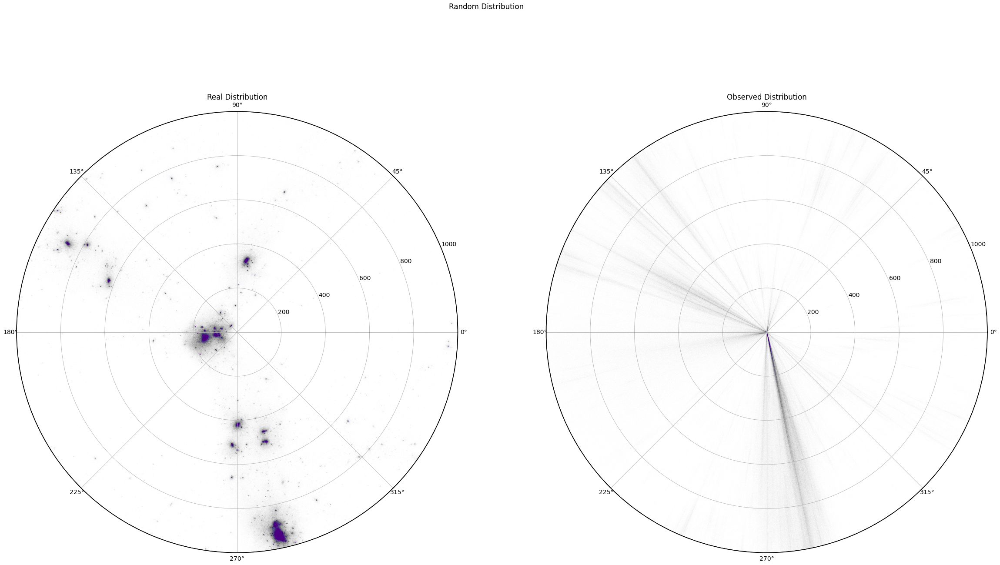

In [25]:
dualPlot(rdf,np.pi/8,rad=1e3,name = "Random Distribution")

In [26]:
fil = rdf.R<2e3
d = rdf[fil].R.values
th = rdf[fil].Th.values
f = rdf[fil].Fi.values
vr = rdf[fil].Vr.values


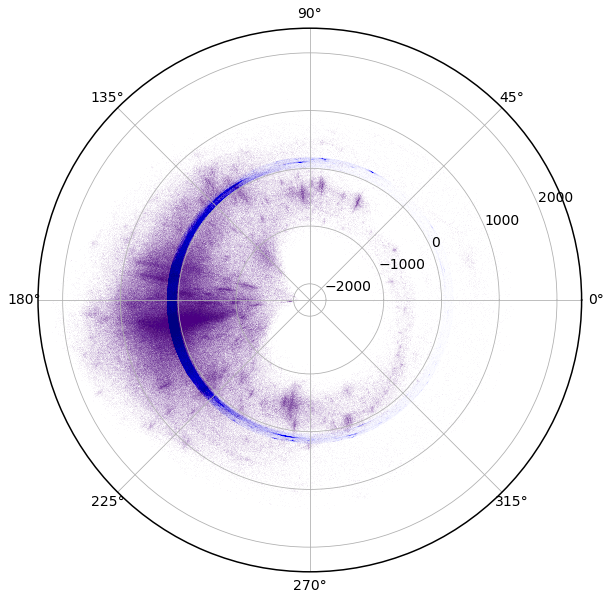

In [27]:
plt.figure(figsize=(20,10))
plt.subplot(projection="polar")
plt.scatter(f,d/10+vr,alpha=0.1,s=0.01,color='indigo')
plt.scatter(f,d/10,alpha=0.01,s=0.01,color='blue')
plt.show()

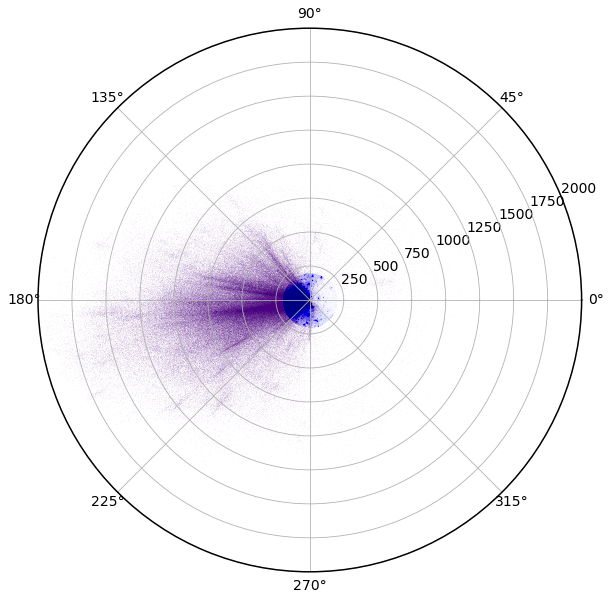

In [28]:
plt.figure(figsize=(20,10))
plt.subplot(projection="polar")
plt.scatter(f,d/10+vr,alpha=0.1,s=0.01,color='indigo')
plt.scatter(f,d/10,alpha=0.01,s=0.01,color='blue')
plt.ylim(0,2e3)
plt.show()

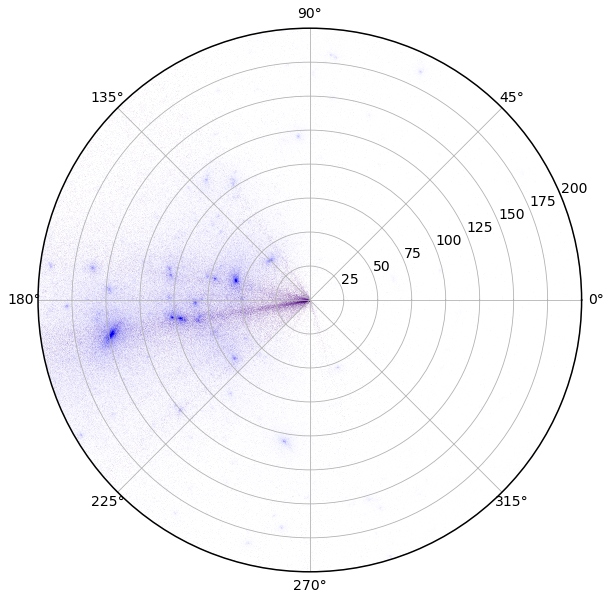

In [29]:
plt.figure(figsize=(20,10))
plt.subplot(projection="polar")
plt.scatter(f,d/10+vr,alpha=0.1,s=0.01,color='indigo')
plt.scatter(f,d/10,alpha=0.01,s=0.01,color='blue')
plt.ylim(0,2e2)
plt.show()

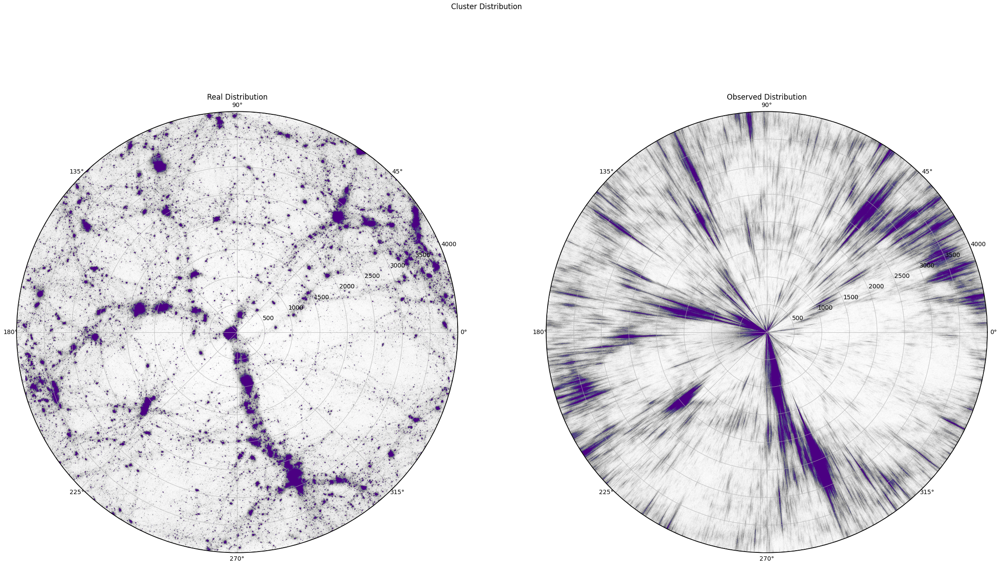

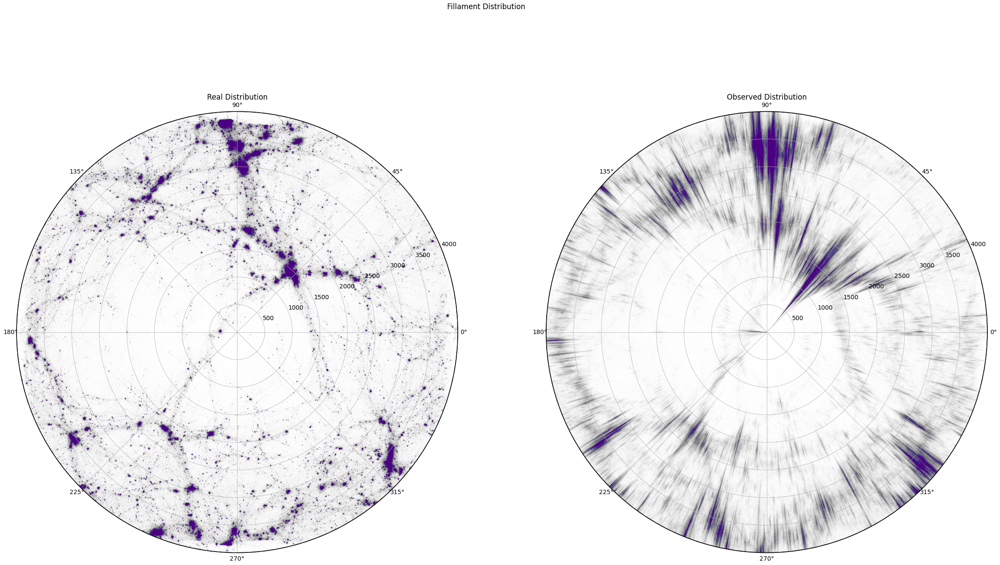

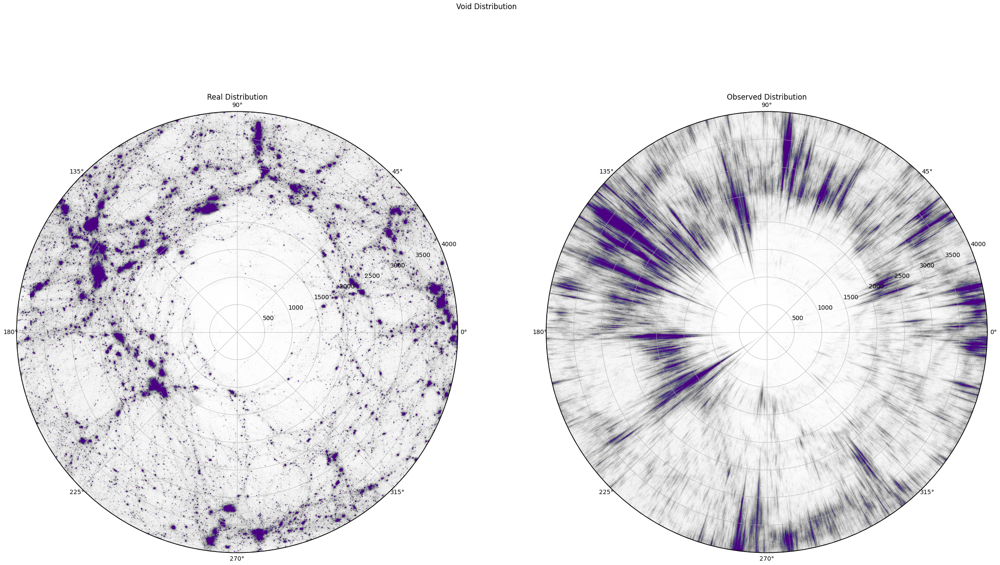

In [30]:
r = 4e3

dualPlot(rdf,np.pi/4,rad=r,name="Cluster Distribution")
dualPlot(tdf,np.pi/8,rad=r,name = "Fillament Distribution")
dualPlot(vdf,np.pi/4,rad=r,name = "Void Distribution")

> DTFE in real and redshift space

> innertia tesonr eigenvalues of a clump to see the shape

> subhalos